# 1. Loading Data into Pandas DataFrame

In [1]:
import pandas as pd
df=pd.read_csv('zomato.csv')

# 2. Getting Rid of NANs

In [2]:
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

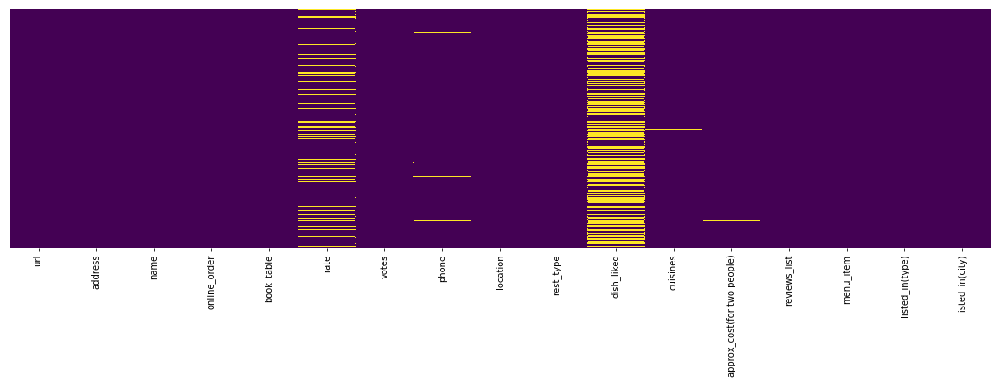

In [4]:
fig, ax = plt.subplots(figsize=(20,5))
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

If we look at the distribution of NANs.Most of NANs are present in dish_liked variables. WE are going to drop that column anyways as its not going to add any significant value to our algoritham.

In [5]:
df=df.drop('dish_liked',axis=1)

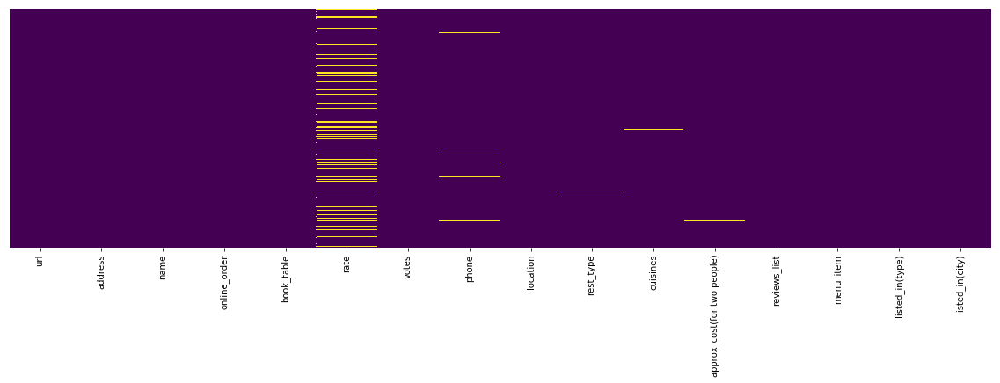

In [6]:
fig, ax = plt.subplots(figsize=(20,5))
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

Since We are going to perform Anomaly detection. Its better to get rid of the NAN or null data as if we fill them somehow, those are oing to appear as anomalies as well in our algo. But we want the anomalies that we are real. Even if those do not appear as anomalies those are going to disrupt the algoritham. 

In [12]:
print(len(df))
df=df.dropna().reset_index(drop=True)
print(len(df))
df.head(1)

42944
42944


,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari


# 3. Pre-processing of the Data

In [18]:
data=df[['online_order','book_table','rest_type','location','rate','votes','approx_cost(for two people)','listed_in(type)']]
data.head(1)

,online_order,book_table,rest_type,location,rate,votes,approx_cost(for two people),listed_in(type)
0,Yes,Yes,Casual Dining,Banashankari,4.1/5,775,800,Buffet


Now We are going to convert our data in the desired formats. 

In [19]:
data['rate']=data['rate'].str.replace('/5','').str.replace('-','0')
data=data[data['rate']!='NEW'].reset_index(drop=True)
data['rate']=data['rate'].astype(float)
data['votes']=data['votes'].astype(int)
data['approx_cost(for two people)']=data['approx_cost(for two people)'].str.replace(',','').astype(int)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [29]:
print(len(data))

40752


We are going to convert our categorical and ordinal variables into numerical data so that our algoritham is able to work on those.

In [22]:
from sklearn.preprocessing import LabelEncoder

categorical = ['online_order', 'book_table', 
               'location', 'rest_type',
               'listed_in(type)']

# Just in case we want to reverse the encoder
encoders = {}

for cat in categorical:
    le = LabelEncoder()
    le = le.fit(data[cat])
    data[cat] = le.transform(data[cat])
    print(f'{cat}: {len(le.classes_)}')
    encoders[cat] = le

online_order: 2
book_table: 2
location: 92
rest_type: 86
listed_in(type): 7


In [23]:
data.head(1)

,online_order,book_table,rest_type,location,rate,votes,approx_cost(for two people),listed_in(type)
0,1,1,24,1,4.1,775,800,0


# 4. Model Design, Fitting and prediction

One Class SVM is basically a type of Support Vector Machines Algoritham. This Algoritham is basically designed to find the outliers or anomalies in the data. 

In [82]:
from sklearn.svm import OneClassSVM
ocsvm_linear=OneClassSVM(nu=0.04,gamma=0.5,kernel='linear')
ocsvm_linear.fit(data)
results_linear=ocsvm_linear.predict(data)

nu decides the amount of percentage that we want to find out from the data as outliers. Gamma basically decides the smoothing of the contour lines.This Model basically is going to tell us that which observation in the datasets are going to be outliers and we are going to index it agains our parent datasets that we used

In [83]:
df=pd.read_csv('zomato.csv')
df=df.drop('dish_liked',axis=1)
df=df.dropna().reset_index(drop=True)
df['rate']=df['rate'].str.replace('/5','').str.replace('-','0')
df=df[df['rate']!='NEW'].reset_index(drop=True)
print(len(df))

40752


We are going to define an outlier column in our parent dataset and 0 wil mean that specific measurement is not an outier based on our analysis in the dataset while 1 means that point is an outlier. We will then map our results against each model to change the value to 1 based on the detection of outliers(anomalies)

In [84]:
df_linear=df
df_linear['OL']=0
df_linear.loc[results_linear==-1,'OL']=1
print(100*len(df_linear[df_linear['OL']==1])/len(df_linear))

3.994895956026698


In [86]:
import plotly.express as px

fig2= px.scatter(df_linear, x='location', y='rate',color="OL", title='Distribution of Location W.r.t Location and Outliers(RBF OneClassSVM)',
                marginal_y="histogram", marginal_x="box")
fig2.show()

In [87]:
import plotly.express as px
fig3 = px.scatter(df_linear, x='rest_type', y='rate',color="OL", title='Ratings of Location W.r.t Resturant Types and Outliers(Linear OneClassSVM)')
fig3.show()

In [89]:
import plotly.express as px
fig5 = px.scatter(df_linear, x='rest_type', y='approx_cost(for two people)',color="OL", title='Cost of 2 people W.r.t Resturant Types and Outliers(linear)')
fig5.show()

In [90]:
fig7 = px.scatter_matrix(df_linear, dimensions=["rate", "approx_cost(for two people)", "votes",], color="OL", title='Distribution matrix(linear)')
fig7.show()

In [91]:
fig9 = px.scatter_3d(df_linear, x='votes', y='rate', z='approx_cost(for two people)',
              color='OL',symbol='OL', opacity=0.7, title='3D view to show Outliers w.r.t Cost, Rating & Vote')
fig9.show()